In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Cargar los datos
houses = pd.read_csv('housing.csv')

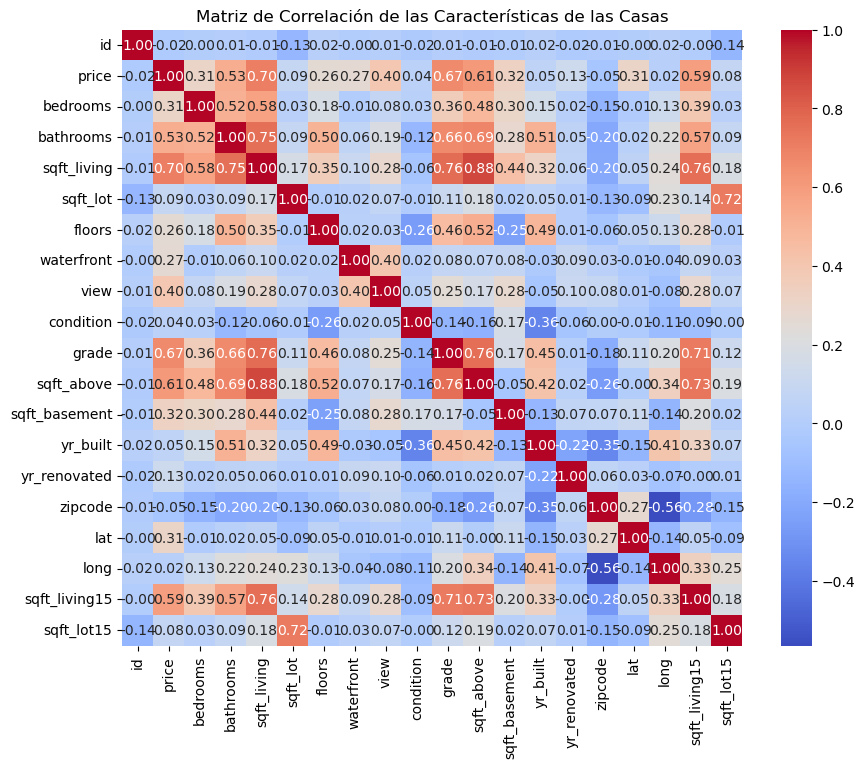

In [2]:
# Eliminar las columnas no numéricas o convertirlas a numéricas si es posible
houses_numeric = houses.select_dtypes(include=[np.number])

# Calcular la matriz de correlación
correlation_matrix = houses_numeric.corr()

# Generar el heatmap utilizando seaborn
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Matriz de Correlación de las Características de las Casas')
plt.show()



In [3]:
houses.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15'],
      dtype='object')

In [4]:
# Show houses on seatle map
import folium
from folium.plugins import MarkerCluster

# Create a map centered at the mean latitude and longitude
houses_map = folium.Map(location=[houses['lat'].mean(), houses['long'].mean()], zoom_start=10)

# Add a marker for each house
marker_cluster = MarkerCluster().add_to(houses_map)
for idx, row in houses.iterrows():
    folium.Marker([row['lat'], row['long']], popup=f"Price: {row['price']}").add_to(marker_cluster)

# Display the map
houses_map.save('houses_map.html')
houses_map

In [10]:
from sklearn.cluster import KMeans

# Select the features to cluster
X = houses[['lat', 'long', 'price']]
X = X.dropna()

# Normalize the features
X = (X - X.mean()) / X.std()

# Cluster the houses
kmeans = KMeans(n_clusters=5)

# Add the cluster to the houses dataframe
houses['cluster'] = kmeans.fit_predict(X)

# Show the clusters on the map
houses_map = folium.Map(location=[houses['lat'].mean(), houses['long'].mean()], zoom_start=10)
colors = ['red', 'blue', 'green', 'purple', 'orange']
marker_cluster = MarkerCluster().add_to(houses_map)
for idx, row in houses.iterrows():
    folium.Marker([row['lat'], row['long']], popup=f"Price: {row['price']}", icon=folium.Icon(color=colors[row['cluster']])).add_to(marker_cluster)

# Display the map
houses_map.save('houses_map_clustered.html')
houses_map

c:\Users\leona\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


AttributeError: 'NoneType' object has no attribute 'split'